# Визуализация графика лосса и работы модели

## Визуализация графиков лосса и метрик

In [2]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np

In [3]:
val_losses = np.loadtxt('val_losses.txt')
val_mses = np.loadtxt('val_scores_metric0.txt')
n_epochs = len(val_losses)

In [4]:
epoch_ends = []
pos = 0
for epoch in range(n_epochs):
    train_loss = np.loadtxt('losses_on_epoch{}.txt'.format(epoch + 1))
    train_mse = np.loadtxt('scores_on_epoch{}_metric0.txt'.format(epoch + 1))
    pos += len(train_loss)
    epoch_ends.append(pos)
    if epoch == 0:
        train_losses = train_loss
        train_mses = train_mse
    else:
        train_losses = np.concatenate([train_losses, train_loss])
        train_mses = np.concatenate([train_mses, train_mse])


In [5]:
def running_mean(X, n):
    cumsum = np.cumsum(X)
    return (cumsum[n:] - cumsum[:-n]) / n

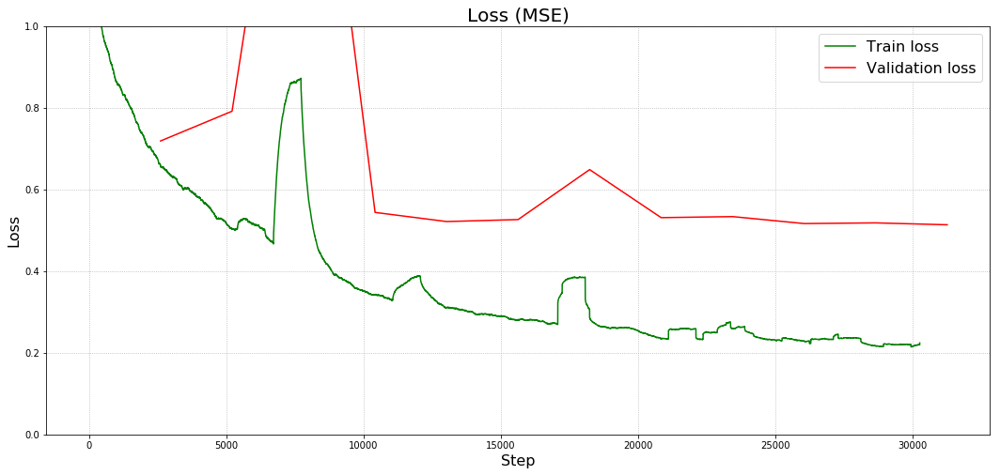

In [7]:
plt.figure(figsize=(18, 8))
plt.title('Loss (MSE)', fontsize=20)
plt.plot(running_mean(train_losses, 1000), color='g', label='Train loss')
plt.plot(epoch_ends, val_losses, color='r', label='Validation loss')
plt.grid(ls=':')
plt.ylim((0., 1.))
plt.xlabel('Step', fontsize=16)
plt.ylabel('Loss', fontsize=16)
plt.legend(fontsize=16)

## Загрузка датасета

In [3]:
import h5py
val_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_scenes.hdf5', 'r')
rgbs_val = np.array(val_data_file['data'])
depths_val = np.array(val_data_file['label'])

In [4]:
test_data_file = h5py.File('/home/kmouraviev/NYU_dataset_hdf5/validation_data_different_collections.hdf5', 'r')
rgbs_test = np.array(test_data_file['data'])
depths_test = np.array(test_data_file['label'])

## Визуализация работы модели

In [5]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '1'

In [6]:
import sys
sys.path.append('/home/kmouraviev')

In [7]:
from tensorflow_resnet.my_batch_normalization import MyBatchNormalization

Using TensorFlow backend.


In [8]:
import tensorflow as tf

In [9]:
def mean_relative_squared_error(labels, predictions):
    sq_error = (labels - predictions) ** 2
    return tf.reduce_mean(sq_error * (1 + 2 * tf.minimum(1 / labels ** 2, 4)))

def relative_error(labels, predictions):
    return tf.abs(labels - predictions) / tf.maximum(labels, 0.5)

def interleave(tensors, axis):
    old_shape = tensors[0].get_shape().as_list()[1:]
    new_shape = [-1] + old_shape
    new_shape[axis] *= len(tensors)
    return tf.reshape(tf.stack(tensors, axis + 1), new_shape)

def interleave_four(tensors):
    in1, in2, in3, in4 = tensors
    inter_12 = interleave([in1, in2], axis=1)
    inter_34 = interleave([in3, in4], axis=1)
    inter = interleave([inter_12, inter_34], axis=2)
    return inter

In [10]:
from keras.models import load_model
model = load_model('model_on_epoch12.hdf5', custom_objects={'MyBatchNormalization': MyBatchNormalization,
                                                            'mean_relative_squared_error': mean_relative_squared_error,
                                                            'relative_error': relative_error,
                                                            'interleave': interleave,
                                                            'interleave_four': interleave_four})

In [11]:
model.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 384, 512, 3)  0                                            
__________________________________________________________________________________________________
zero_padding2d_1 (ZeroPadding2D (None, 390, 518, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 192, 256, 64) 9408        zero_padding2d_1[0][0]           
__________________________________________________________________________________________________
my_batch_normalization_1 (MyBat (None, 192, 256, 64) 256         conv2d_1[0][0]                   
__________________________________________________________________________________________________
activation

### Валидация на тех же коллекциях

In [12]:
val_prediction = model.predict(rgbs_val, batch_size=1)
mse = np.mean((val_prediction - depths_val) ** 2)
print('MSE on different scenes:', mse)
rel_error = np.mean(np.abs(val_prediction - depths_val) / np.maximum(depths_val, 0.5))
print('Relative error on different scenes:', rel_error)

MSE on different scenes: 0.5136050772295501
Relative error on different scenes: 0.2059467674766621


In [13]:
val_prediction = np.maximum(val_prediction, 0.5)
depths_val = np.maximum(depths_val, 0.5)
rel_error = np.maximum(val_prediction / depths_val, depths_val / val_prediction)
print('val delta_1:', np.mean(rel_error < 1.25))
print('val delta_2:', np.mean(rel_error < 1.25 ** 2))
print('val delta_3:', np.mean(rel_error < 1.25 ** 3))

val delta_1: 0.708338942269955
val delta_2: 0.9124136940386425
val delta_3: 0.9700722183889973


In [19]:
def unpreprocess(img):
    img_min = -123
    img_max = 151
    return (img - img_min) / (img_max - img_min)

/home/kmouraviev/anaconda/envs/tensorflow_py36_1/lib/python3.6/site-packages/matplotlib/pyplot.py:514: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


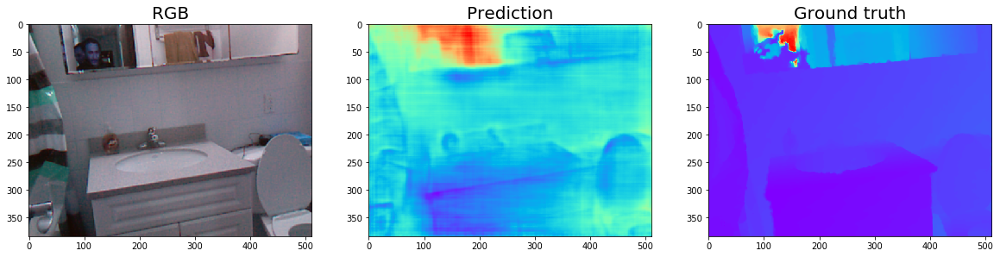

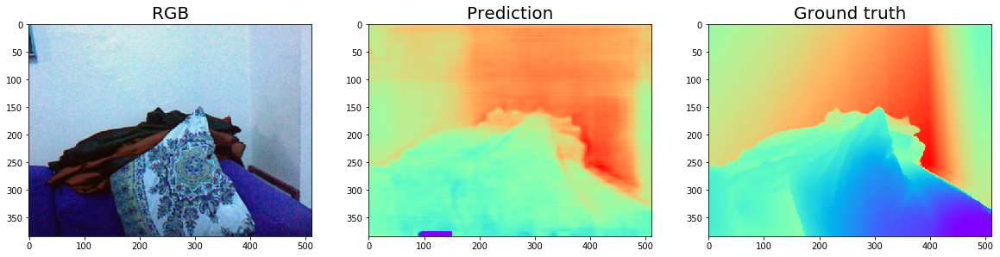

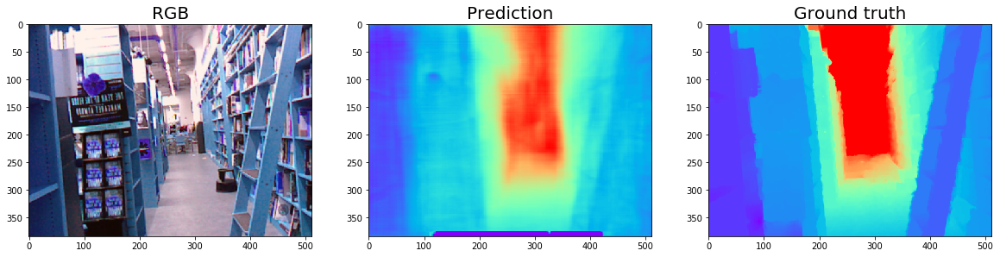

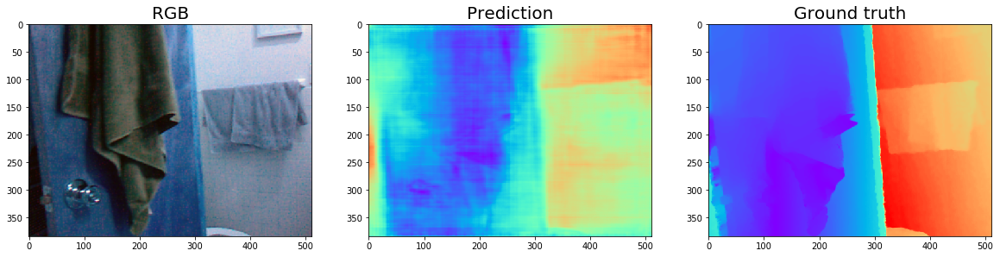

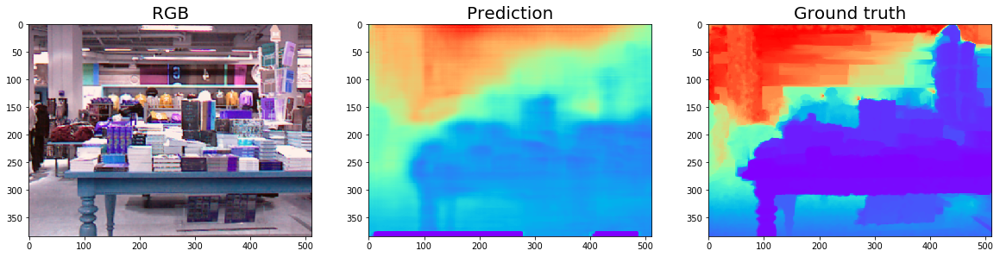

...

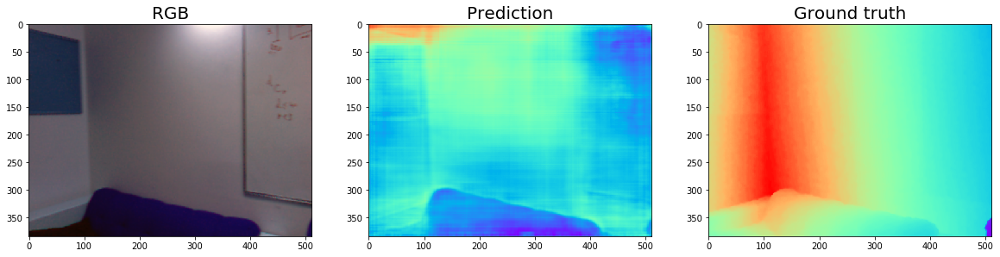

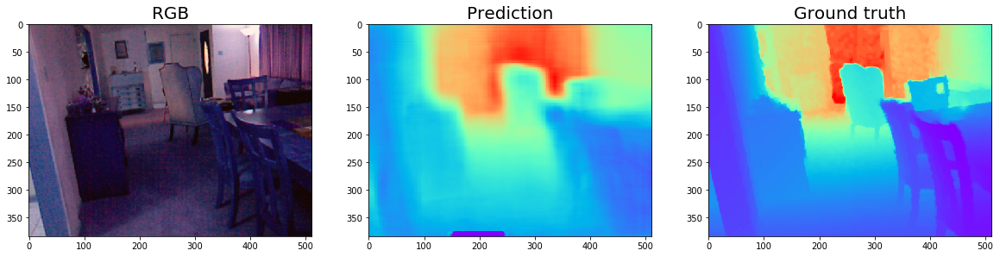

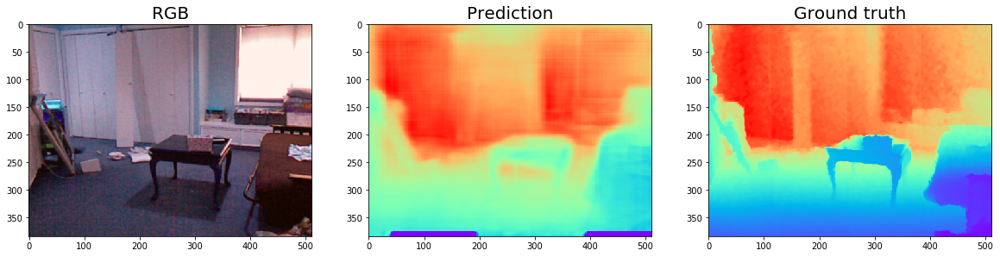

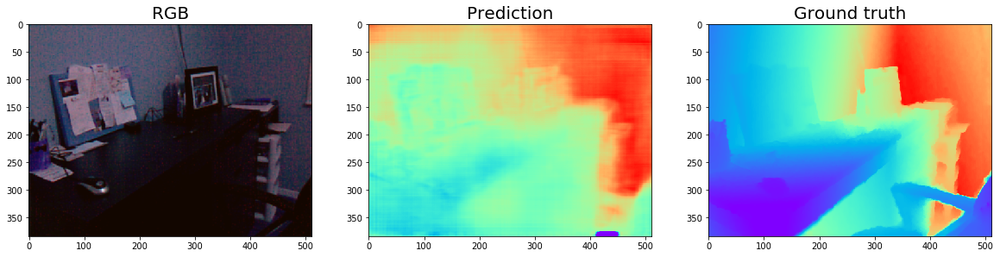

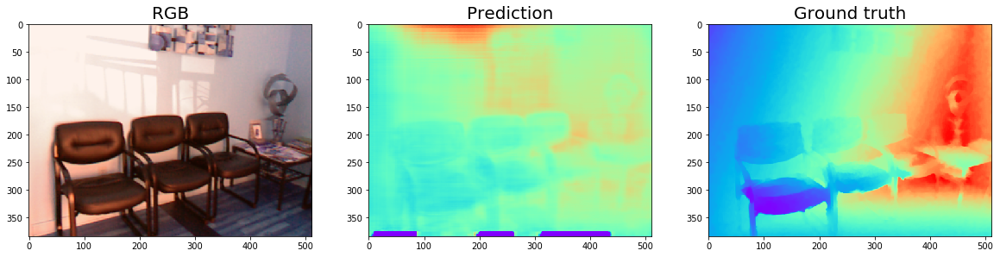

In [20]:
rgbs_val_sample = rgbs_val[::534]
depths_val_sample = depths_val[::534]
val_prediction_sample = model.predict(rgbs_val_sample)
for i in range(len(rgbs_val_sample)):
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 3, 1)
    plt.title('RGB', fontsize=20)
    plt.imshow(unpreprocess(rgbs_val_sample[i]))
    plt.subplot(1, 3, 2)
    plt.title('Prediction', fontsize=20)
    plt.imshow(val_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(1, 3, 3)
    plt.title('Ground truth', fontsize=20)
    plt.imshow(depths_val_sample[i] / 10, cmap='rainbow')

In [21]:
error = (val_prediction - depths_val) ** 2
relative_error = np.abs(val_prediction - depths_val) / np.maximum(depths_val, 0.5)
target_pixels = (depths_val < 1)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth < 1m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_val > 1, depths_val < 2)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 1m and 2m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_val > 2, depths_val < 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 2m and 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = (depths_val > 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth > 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')

On objects with depth < 1m:
MSE: 0.6065163220029814
Relative_error: 0.7143157308326742


On objects with depth between 1m and 2m:
MSE: 0.2768840579670974
Relative_error: 0.24977120667138256


On objects with depth between 2m and 5m:
MSE: 0.4093442766756573
Relative_error: 0.14068686526572827


On objects with depth > 5m:
MSE: 1.7744676767651018
Relative_error: 0.15714862398269042




### Валидация на других коллекциях

In [14]:
test_prediction = model.predict(rgbs_test, batch_size=1)
mse = np.mean((test_prediction - depths_test) ** 2)
print('MSE on different collections:', mse)
rel_error = np.mean(np.abs(test_prediction - depths_test) / np.maximum(depths_test, 0.5))
print('Relative error on different scenes:', rel_error)

MSE on different collections: 0.7159804074717728
Relative error on different scenes: 0.25108096598517154


In [15]:
test_prediction = np.maximum(test_prediction, 0.5)
depths_test = np.maximum(depths_test, 0.5)
rel_error = np.maximum(test_prediction / depths_test, depths_test / test_prediction)
print('Test delta_1:', np.mean(rel_error < 1.25))
print('Test delta_2:', np.mean(rel_error < 1.25 ** 2))
print('Test delta_3:', np.mean(rel_error < 1.25 ** 3))

Test delta_1: 0.6277564404096673
Test delta_2: 0.8615129263334683
Test delta_3: 0.9499355856269731


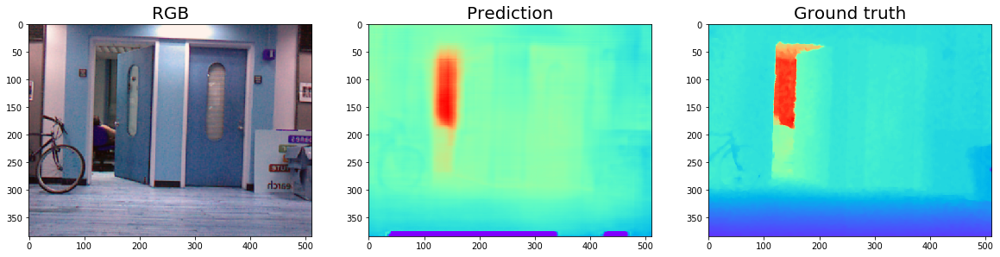

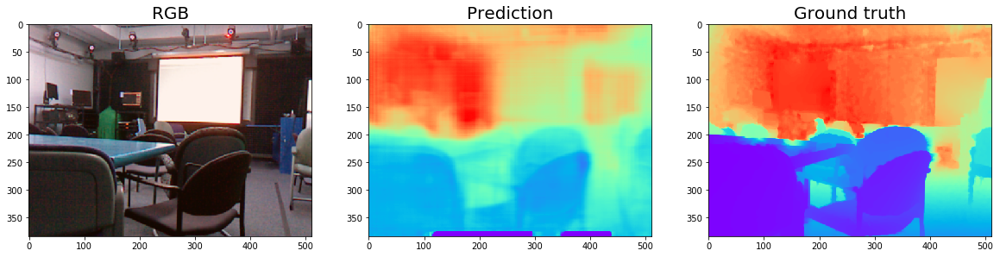

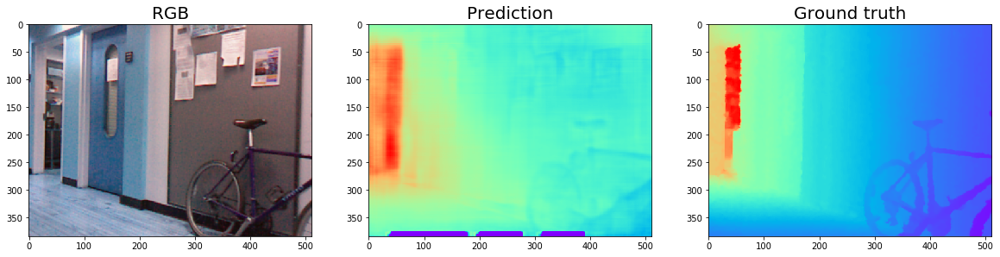

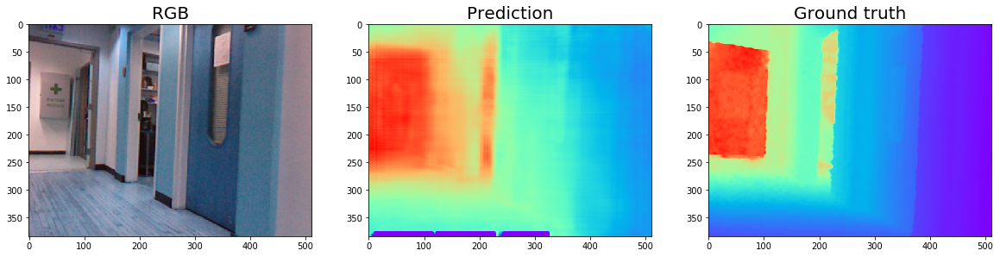

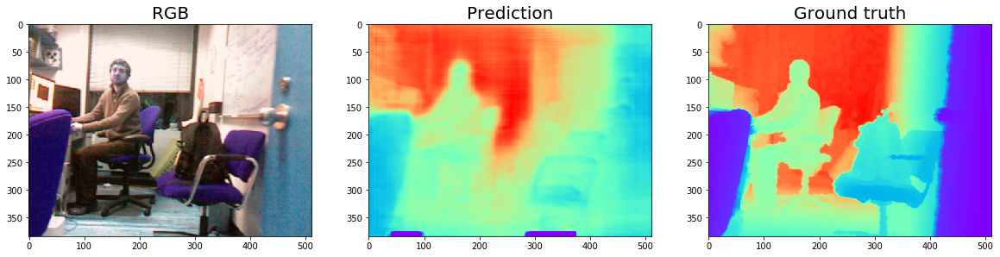

...

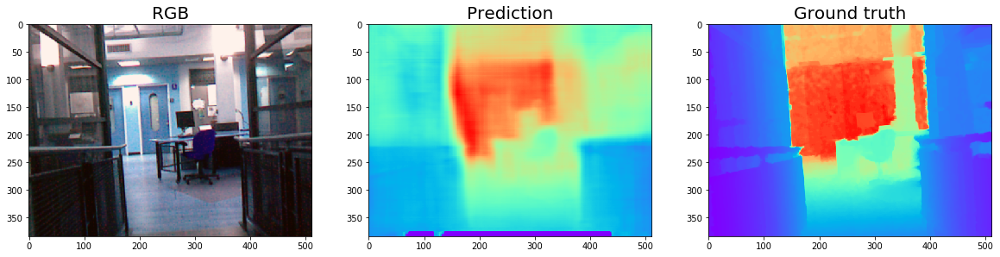

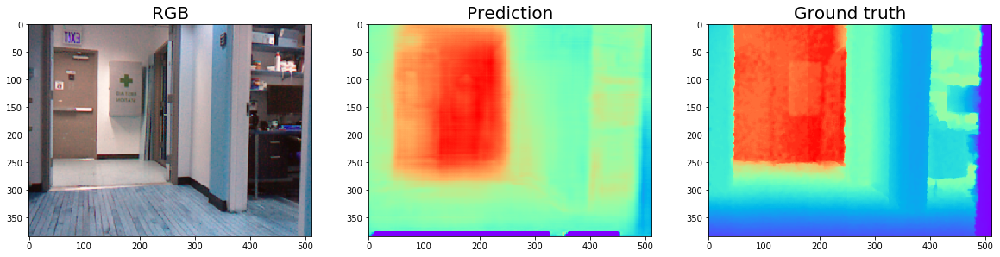

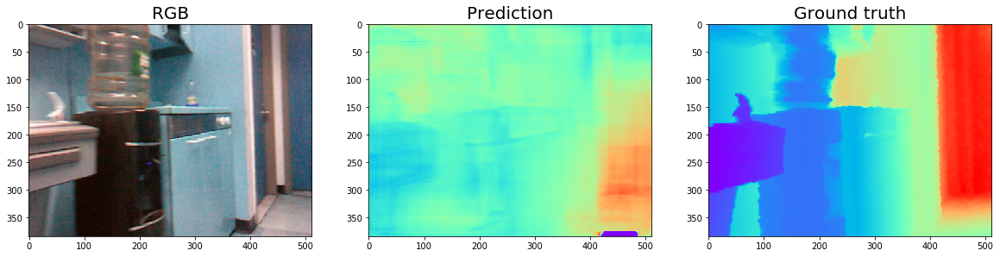

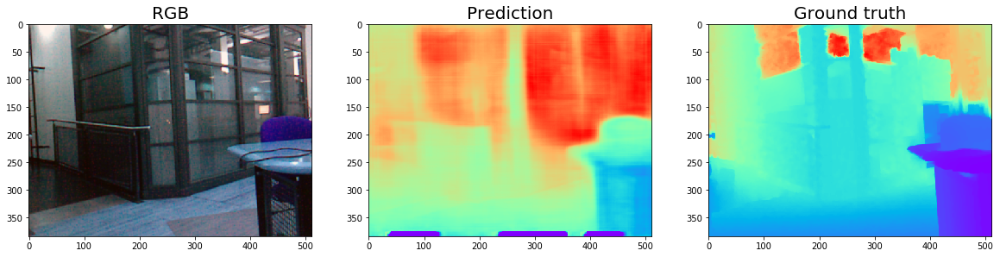

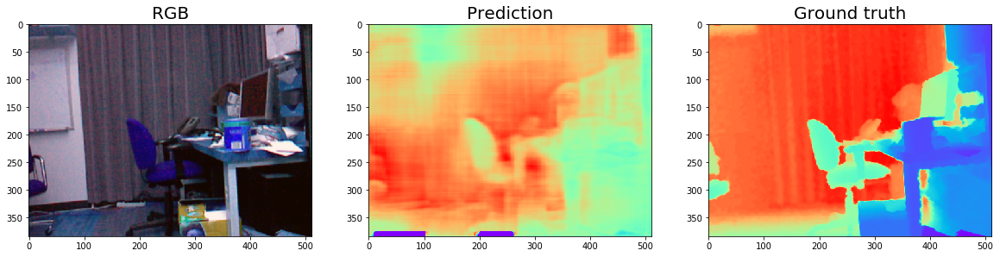

In [23]:
rgbs_test_sample = rgbs_test[::128]
depths_test_sample = depths_test[::128]
test_prediction_sample = model.predict(rgbs_test_sample)
for i in range(len(rgbs_test_sample)):
    plt.figure(figsize=(20, 6))
    plt.subplot(1, 3, 1)
    plt.title('RGB', fontsize=20)
    plt.imshow(unpreprocess(rgbs_test_sample[i]))
    plt.subplot(1, 3, 2)
    plt.title('Prediction', fontsize=20)
    plt.imshow(test_prediction_sample[i] / 10, cmap='rainbow')
    plt.subplot(1, 3, 3)
    plt.title('Ground truth', fontsize=20)
    plt.imshow(depths_test_sample[i] / 10, cmap='rainbow')

In [24]:
error = (test_prediction - depths_test) ** 2
relative_error = np.abs(test_prediction - depths_test) / np.maximum(depths_test, 0.5)
target_pixels = (depths_test < 1)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth < 1m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_test > 1, depths_test < 2)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 1m and 2m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = np.logical_and(depths_test > 2, depths_test < 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth between 2m and 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')
target_pixels = (depths_test > 5)
target_mse = (error * target_pixels).sum() / target_pixels.sum()
target_rel_error = (relative_error * target_pixels).sum() / target_pixels.sum()
print('On objects with depth > 5m:')
print('MSE:', target_mse)
print('Relative_error:', target_rel_error)
print('\n')

On objects with depth < 1m:
MSE: 0.6566105965651068
Relative_error: 0.8670123257118747


On objects with depth between 1m and 2m:
MSE: 0.39968120387645295
Relative_error: 0.3460179821043806


On objects with depth between 2m and 5m:
MSE: 0.4864169587345128
Relative_error: 0.17031199926488944


On objects with depth > 5m:
MSE: 2.2697731847888396
Relative_error: 0.16815126185512486


